In [16]:
import numpy as np
import torch
from torch import nn, optim
from torchvision import transforms, datasets, utils
from torchsummary import summary
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML
import pickle

In [2]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print(f"Using device: {device.type}")

Using device: cuda


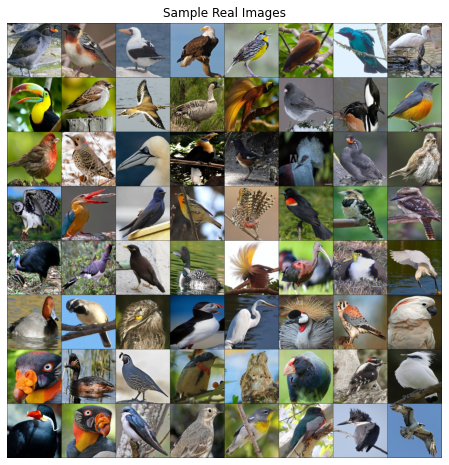

In [3]:
DATA_DIR = "data/consolidated/"

BATCH_SIZE = 64

# Images are 3 x 224 x 224
data_transforms = transforms.Compose([
    transforms.ToTensor()
])

dataset = datasets.ImageFolder(root=DATA_DIR,
                               transform=data_transforms)

data_loader = torch.utils.data.DataLoader(dataset,
                                          batch_size=BATCH_SIZE,
                                          shuffle=True,
                                          drop_last=False)

# Plot samples
sample_batch = next(iter(data_loader))
plt.figure(figsize=(10, 8)); plt.axis("off"); plt.title("Sample Real Images")
plt.imshow(np.transpose(utils.make_grid(sample_batch[0], padding=1, normalize=True), (1, 2, 0)));

In [4]:
# Weight initialization as suggested in literature
def weights_init(m):
    if isinstance(m, (nn.Conv2d, nn.ConvTranspose2d)):
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif isinstance(m, nn.BatchNorm2d):
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

In [5]:
def convtrans_block(in_channels, out_channels, kernel_size, stride, padding):
    return nn.Sequential(
        nn.ConvTranspose2d(in_channels, out_channels, kernel_size, stride, padding, bias=False),    # bias not needed because of BatchNorm
        nn.BatchNorm2d(out_channels),
        nn.ReLU()
    )

class Generator(nn.Module):
    def __init__(self, LATENT_SIZE):
        super().__init__()
        self.main = nn.Sequential(
            convtrans_block(LATENT_SIZE, 512, kernel_size=4, stride=2, padding=1),
            convtrans_block(512, 256, kernel_size=4, stride=2, padding=0),
            convtrans_block(256, 128, kernel_size=4, stride=2, padding=0),
            convtrans_block(128, 64, kernel_size=4, stride=2, padding=1),
            convtrans_block(64, 64, kernel_size=4, stride=2, padding=1),
            convtrans_block(64, 64, kernel_size=4, stride=2, padding=1),
            nn.ConvTranspose2d(64, 3, kernel_size=4, stride=2, padding=1),
            nn.Tanh()
        )

    def forward(self, x):
        return self.main(x)

LATENT_SIZE = 128
    
generator = Generator(LATENT_SIZE)
generator.apply(weights_init)
generator.to(device)
summary(generator, (LATENT_SIZE, 1, 1))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
   ConvTranspose2d-1            [-1, 512, 2, 2]       1,048,576
       BatchNorm2d-2            [-1, 512, 2, 2]           1,024
              ReLU-3            [-1, 512, 2, 2]               0
   ConvTranspose2d-4            [-1, 256, 6, 6]       2,097,152
       BatchNorm2d-5            [-1, 256, 6, 6]             512
              ReLU-6            [-1, 256, 6, 6]               0
   ConvTranspose2d-7          [-1, 128, 14, 14]         524,288
       BatchNorm2d-8          [-1, 128, 14, 14]             256
              ReLU-9          [-1, 128, 14, 14]               0
  ConvTranspose2d-10           [-1, 64, 28, 28]         131,072
      BatchNorm2d-11           [-1, 64, 28, 28]             128
             ReLU-12           [-1, 64, 28, 28]               0
  ConvTranspose2d-13           [-1, 64, 56, 56]          65,536
      BatchNorm2d-14           [-1, 64,

In [6]:
def conv_block(in_channels, out_channels, kernel_size, stride, padding):
    return nn.Sequential(
        nn.Conv2d(in_channels, out_channels, kernel_size, stride, padding, bias=False),    # bias not needed because of BatchNorm
        nn.BatchNorm2d(out_channels),
        nn.LeakyReLU(0.2, True)
    )

class Discriminator(nn.Module):
    def __init__(self):
        super().__init__()
        self.main = nn.Sequential(
            conv_block(3, 64, kernel_size=4, stride=2, padding=1),
            conv_block(64, 128, kernel_size=4, stride=2, padding=1),
            conv_block(128, 256, kernel_size=4, stride=2, padding=1),
            conv_block(256, 256, kernel_size=4, stride=2, padding=1),
            conv_block(256, 256, kernel_size=4, stride=2, padding=1),
            conv_block(256, 256, kernel_size=4, stride=2, padding=1),
            nn.Conv2d(256, 1, kernel_size=4, stride=2, padding=1),
            nn.Sigmoid()
        )

    def forward(self, x):
        return self.main(x)
    
discriminator = Discriminator()
discriminator.apply(weights_init)
discriminator.to(device);
summary(discriminator, (3, 224, 224))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1         [-1, 64, 112, 112]           3,072
       BatchNorm2d-2         [-1, 64, 112, 112]             128
         LeakyReLU-3         [-1, 64, 112, 112]               0
            Conv2d-4          [-1, 128, 56, 56]         131,072
       BatchNorm2d-5          [-1, 128, 56, 56]             256
         LeakyReLU-6          [-1, 128, 56, 56]               0
            Conv2d-7          [-1, 256, 28, 28]         524,288
       BatchNorm2d-8          [-1, 256, 28, 28]             512
         LeakyReLU-9          [-1, 256, 28, 28]               0
           Conv2d-10          [-1, 256, 14, 14]       1,048,576
      BatchNorm2d-11          [-1, 256, 14, 14]             512
        LeakyReLU-12          [-1, 256, 14, 14]               0
           Conv2d-13            [-1, 256, 7, 7]       1,048,576
      BatchNorm2d-14            [-1, 25

Begin training...
Epoch (1/200) Iteration (1) Loss_G: 13.4193 Loss_D: 1.4506 D_real: 0.4724 D_fake: 0.4664
Epoch (1/200) Iteration (51) Loss_G: 5.8524 Loss_D: 0.1527 D_real: 0.9824 D_fake: 0.1239
Epoch (1/200) Iteration (101) Loss_G: 4.8779 Loss_D: 0.0236 D_real: 0.9947 D_fake: 0.0181
Epoch (1/200) Iteration (151) Loss_G: 3.5204 Loss_D: 0.0880 D_real: 0.9865 D_fake: 0.0712
Epoch (1/200) Iteration (201) Loss_G: 5.9960 Loss_D: 0.0714 D_real: 0.9954 D_fake: 0.0644
Epoch (1/200) Iteration (251) Loss_G: 5.6270 Loss_D: 0.0114 D_real: 0.9987 D_fake: 0.0100
Epoch (1/200) Iteration (301) Loss_G: 6.2053 Loss_D: 0.0043 D_real: 0.9988 D_fake: 0.0031
Epoch (1/200) Iteration (351) Loss_G: 5.6067 Loss_D: 0.1372 D_real: 0.9831 D_fake: 0.1122
Epoch (1/200) Iteration (401) Loss_G: 5.0029 Loss_D: 0.0282 D_real: 0.9835 D_fake: 0.0110
Epoch (1/200) Iteration (451) Loss_G: 4.4514 Loss_D: 0.0751 D_real: 0.9553 D_fake: 0.0254
Epoch (1/200) Iteration (501) Loss_G: 1.5245 Loss_D: 0.5910 D_real: 0.7815 D_fake: 0

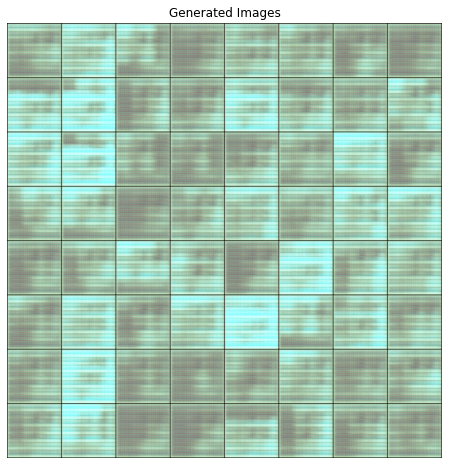


Printing every epoch to reduce verbosity

Epoch (2/200) Iteration (591) Loss_G: 3.0170 Loss_D: 0.4956 D_real: 0.7278 D_fake: 0.1020
Epoch (3/200) Iteration (1181) Loss_G: 3.6877 Loss_D: 0.9982 D_real: 0.9058 D_fake: 0.5277


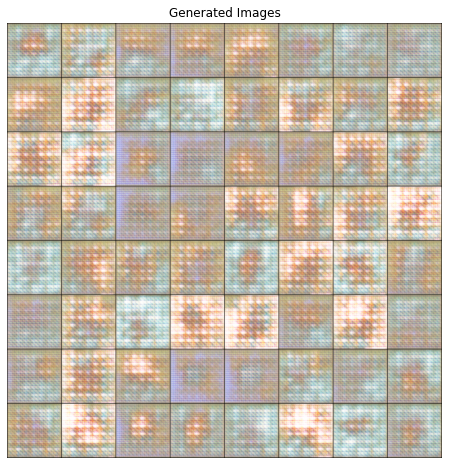

Epoch (4/200) Iteration (1771) Loss_G: 2.6629 Loss_D: 0.7525 D_real: 0.7456 D_fake: 0.3279
Epoch (5/200) Iteration (2361) Loss_G: 3.6345 Loss_D: 0.4819 D_real: 0.8105 D_fake: 0.2107


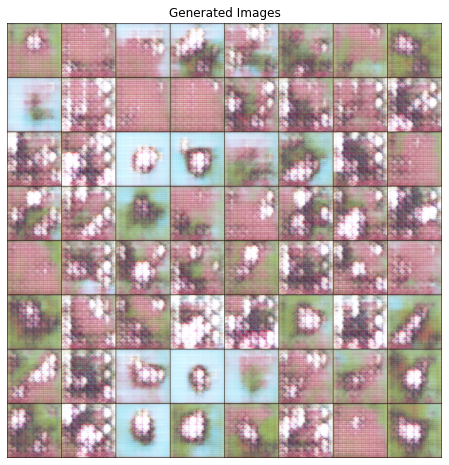

Epoch (6/200) Iteration (2951) Loss_G: 5.0229 Loss_D: 1.0515 D_real: 0.8214 D_fake: 0.5146
Epoch (7/200) Iteration (3541) Loss_G: 2.6324 Loss_D: 0.8143 D_real: 0.5261 D_fake: 0.0485


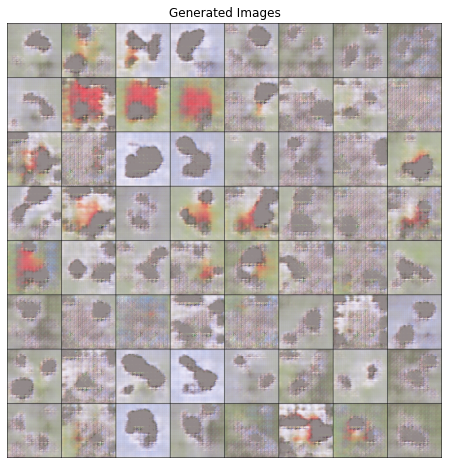

Epoch (8/200) Iteration (4131) Loss_G: 4.0271 Loss_D: 0.8322 D_real: 0.9608 D_fake: 0.4795
Epoch (9/200) Iteration (4721) Loss_G: 4.7983 Loss_D: 2.8717 D_real: 0.0905 D_fake: 0.0011


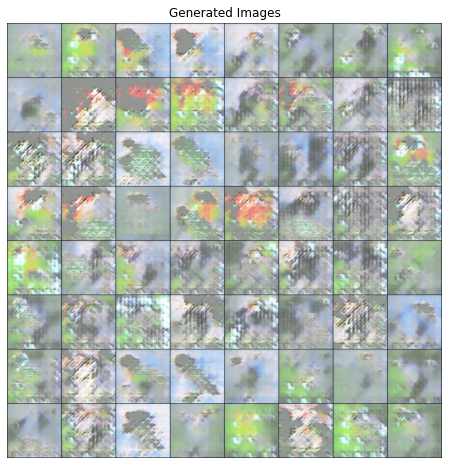

Epoch (10/200) Iteration (5311) Loss_G: 6.1606 Loss_D: 0.3523 D_real: 0.7628 D_fake: 0.0072
Epoch (11/200) Iteration (5901) Loss_G: 7.0660 Loss_D: 4.6263 D_real: 0.0439 D_fake: 0.0001


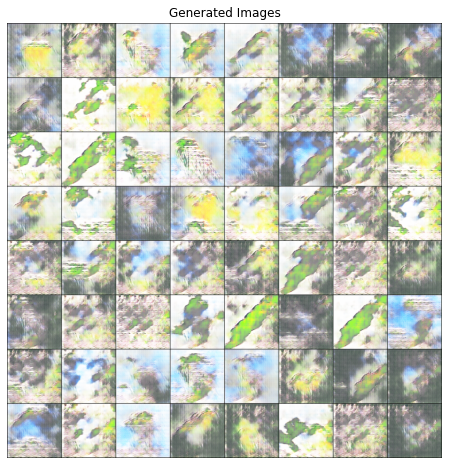

Epoch (12/200) Iteration (6491) Loss_G: 7.1874 Loss_D: 0.1528 D_real: 0.9764 D_fake: 0.1005
Epoch (13/200) Iteration (7081) Loss_G: 6.3421 Loss_D: 0.0946 D_real: 0.9380 D_fake: 0.0249


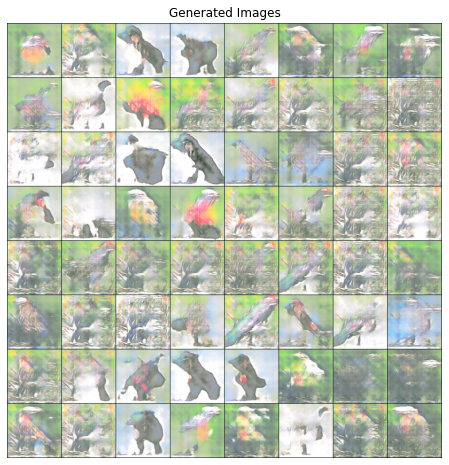

Epoch (14/200) Iteration (7671) Loss_G: 8.9943 Loss_D: 0.2915 D_real: 0.9664 D_fake: 0.1448
Epoch (15/200) Iteration (8261) Loss_G: 20.0342 Loss_D: 1.7303 D_real: 0.9956 D_fake: 0.7352


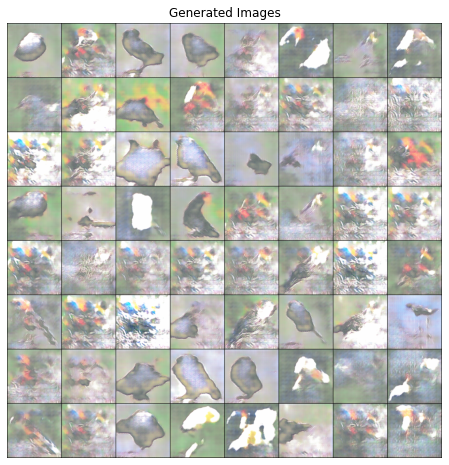

Epoch (16/200) Iteration (8851) Loss_G: 5.5823 Loss_D: 0.3324 D_real: 0.8948 D_fake: 0.1079
Epoch (17/200) Iteration (9441) Loss_G: 6.3698 Loss_D: 0.1196 D_real: 0.9177 D_fake: 0.0189


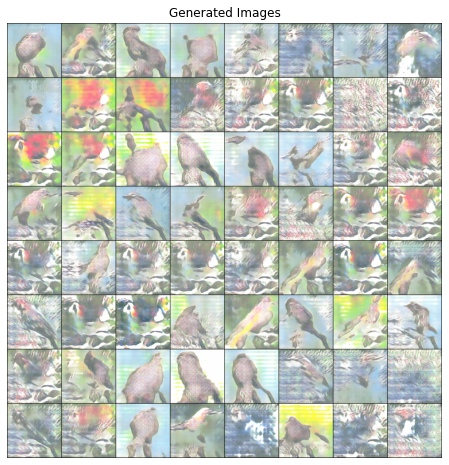

Epoch (18/200) Iteration (10031) Loss_G: 5.9601 Loss_D: 0.1115 D_real: 0.9899 D_fake: 0.0895
Epoch (19/200) Iteration (10621) Loss_G: 6.6535 Loss_D: 0.2929 D_real: 0.9564 D_fake: 0.1938


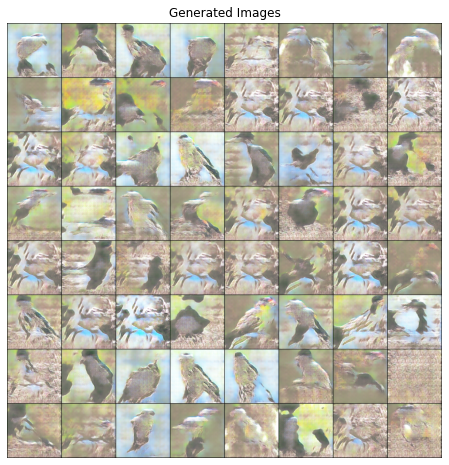

Epoch (20/200) Iteration (11211) Loss_G: 6.0377 Loss_D: 0.0941 D_real: 0.9329 D_fake: 0.0034
Epoch (21/200) Iteration (11801) Loss_G: 2.2161 Loss_D: 0.2321 D_real: 0.8286 D_fake: 0.0084


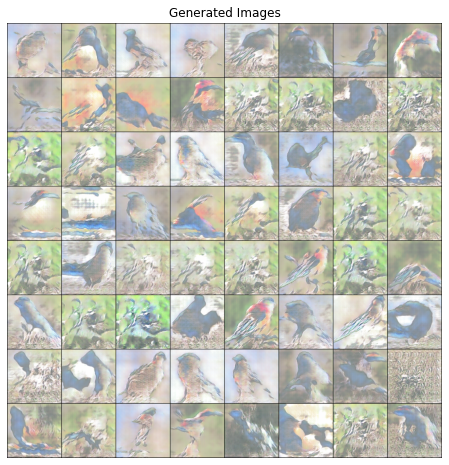

Epoch (22/200) Iteration (12391) Loss_G: 6.7756 Loss_D: 0.2322 D_real: 0.9768 D_fake: 0.1521
Epoch (23/200) Iteration (12981) Loss_G: 14.3231 Loss_D: 0.9708 D_real: 0.9820 D_fake: 0.4559


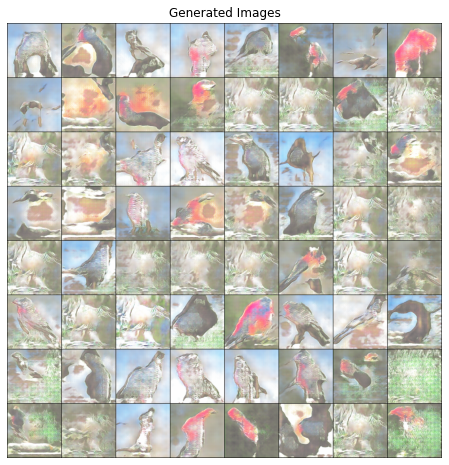

Epoch (24/200) Iteration (13571) Loss_G: 7.3202 Loss_D: 0.2541 D_real: 0.9970 D_fake: 0.1730
Epoch (25/200) Iteration (14161) Loss_G: 7.2364 Loss_D: 0.0237 D_real: 0.9798 D_fake: 0.0027


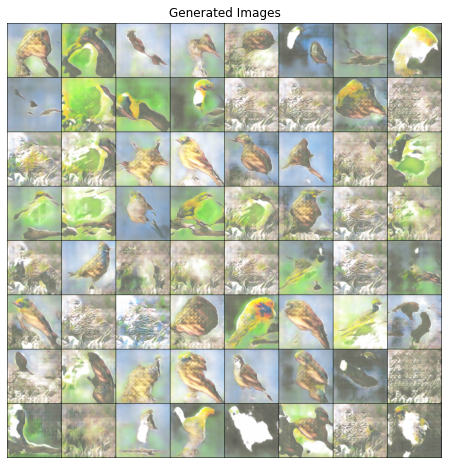

Epoch (26/200) Iteration (14751) Loss_G: 8.0624 Loss_D: 0.7639 D_real: 0.9971 D_fake: 0.3688
Epoch (27/200) Iteration (15341) Loss_G: 11.1504 Loss_D: 0.8041 D_real: 0.9705 D_fake: 0.3788


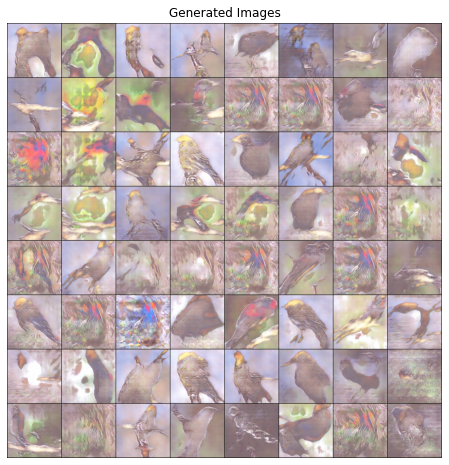

Epoch (28/200) Iteration (15931) Loss_G: 5.3132 Loss_D: 0.1040 D_real: 0.9772 D_fake: 0.0615
Epoch (29/200) Iteration (16521) Loss_G: 18.2237 Loss_D: 1.2106 D_real: 0.9993 D_fake: 0.6032


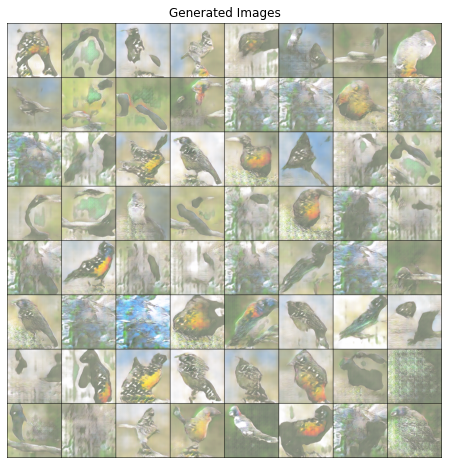

Epoch (30/200) Iteration (17111) Loss_G: 14.9084 Loss_D: 0.6783 D_real: 0.9998 D_fake: 0.3777
Epoch (31/200) Iteration (17701) Loss_G: 7.8394 Loss_D: 0.0026 D_real: 0.9995 D_fake: 0.0021


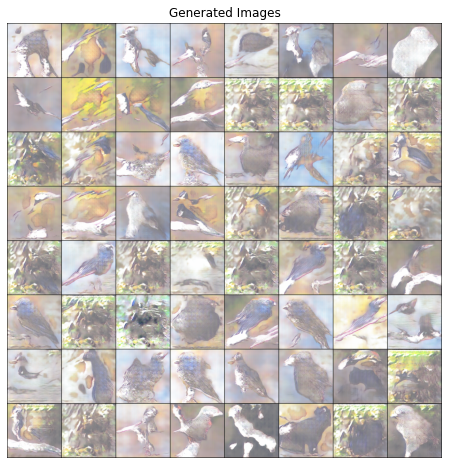

Epoch (32/200) Iteration (18291) Loss_G: 4.0734 Loss_D: 0.2289 D_real: 0.8465 D_fake: 0.0084
Epoch (33/200) Iteration (18881) Loss_G: 14.3029 Loss_D: 0.2550 D_real: 0.8466 D_fake: 0.0001


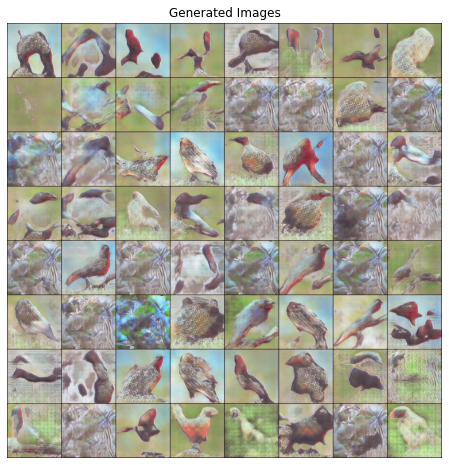

Epoch (34/200) Iteration (19471) Loss_G: 6.5128 Loss_D: 0.0187 D_real: 0.9965 D_fake: 0.0148
Epoch (35/200) Iteration (20061) Loss_G: 7.6418 Loss_D: 0.1503 D_real: 0.8806 D_fake: 0.0014


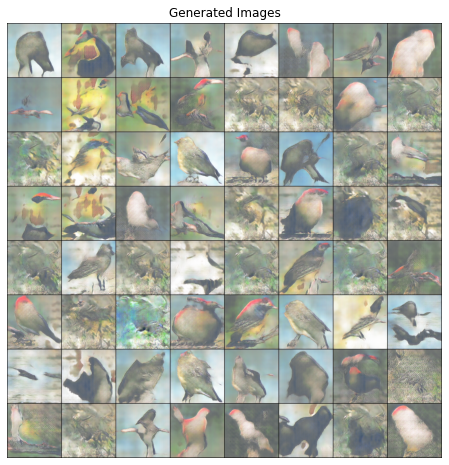

Epoch (36/200) Iteration (20651) Loss_G: 8.2654 Loss_D: 0.0736 D_real: 0.9381 D_fake: 0.0005
Epoch (37/200) Iteration (21241) Loss_G: 21.0796 Loss_D: 3.6879 D_real: 1.0000 D_fake: 0.9146


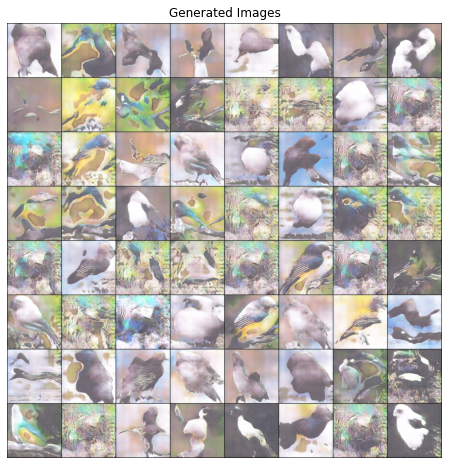

Epoch (38/200) Iteration (21831) Loss_G: 7.7042 Loss_D: 0.2279 D_real: 0.9952 D_fake: 0.1622
Epoch (39/200) Iteration (22421) Loss_G: 9.0183 Loss_D: 0.0096 D_real: 0.9915 D_fake: 0.0009


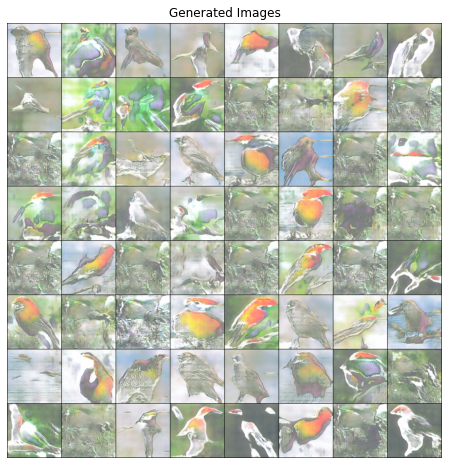

Epoch (40/200) Iteration (23011) Loss_G: 5.3004 Loss_D: 0.0281 D_real: 0.9926 D_fake: 0.0197
Epoch (41/200) Iteration (23601) Loss_G: 6.4113 Loss_D: 0.1745 D_real: 0.9292 D_fake: 0.0491


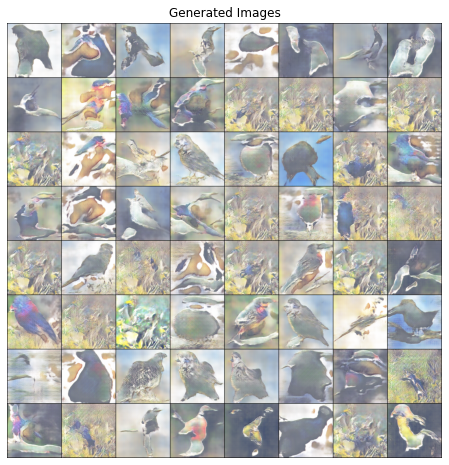

Epoch (42/200) Iteration (24191) Loss_G: 7.7756 Loss_D: 0.0275 D_real: 0.9759 D_fake: 0.0025
Epoch (43/200) Iteration (24781) Loss_G: 6.8966 Loss_D: 0.0176 D_real: 0.9946 D_fake: 0.0118


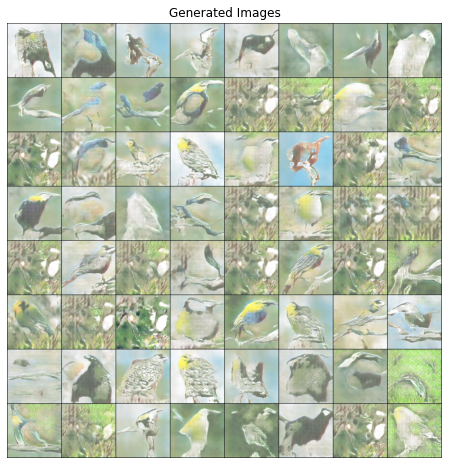

Epoch (44/200) Iteration (25371) Loss_G: 8.2738 Loss_D: 0.0386 D_real: 0.9743 D_fake: 0.0068
Epoch (45/200) Iteration (25961) Loss_G: 10.8031 Loss_D: 0.0834 D_real: 0.9296 D_fake: 0.0001


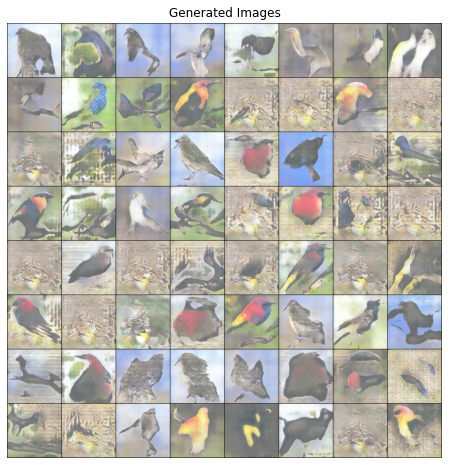

Epoch (46/200) Iteration (26551) Loss_G: 7.1111 Loss_D: 0.0038 D_real: 0.9998 D_fake: 0.0036
Epoch (47/200) Iteration (27141) Loss_G: 3.8468 Loss_D: 0.3068 D_real: 0.9999 D_fake: 0.1710


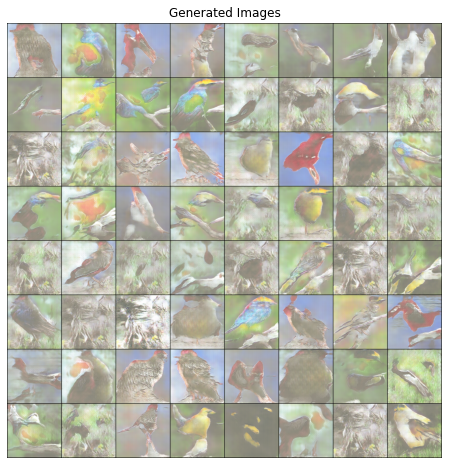

Epoch (48/200) Iteration (27731) Loss_G: 6.8135 Loss_D: 0.0406 D_real: 0.9946 D_fake: 0.0315
Epoch (49/200) Iteration (28321) Loss_G: 6.6164 Loss_D: 0.0370 D_real: 0.9838 D_fake: 0.0189


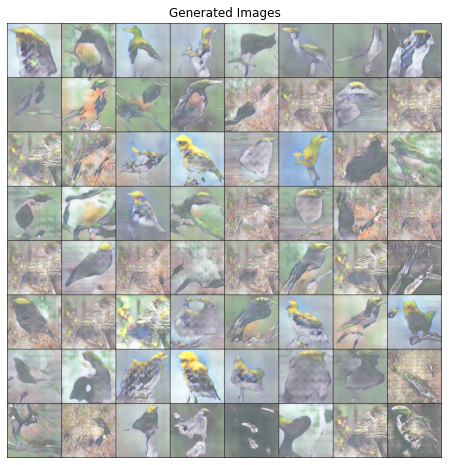

Epoch (50/200) Iteration (28911) Loss_G: 5.8454 Loss_D: 0.2650 D_real: 0.9243 D_fake: 0.1224
Epoch (51/200) Iteration (29501) Loss_G: 22.8074 Loss_D: 1.6254 D_real: 1.0000 D_fake: 0.5385


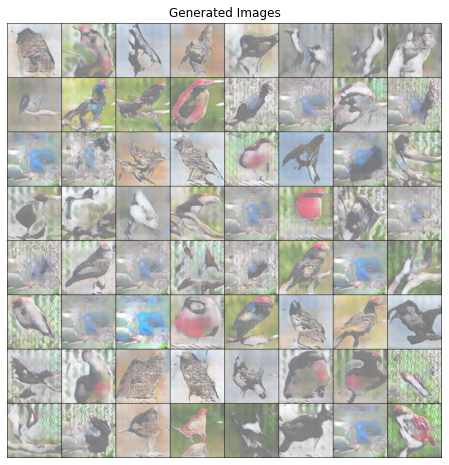

Epoch (52/200) Iteration (30091) Loss_G: 8.8449 Loss_D: 0.0029 D_real: 0.9991 D_fake: 0.0019
Epoch (53/200) Iteration (30681) Loss_G: 19.3314 Loss_D: 0.5658 D_real: 0.9996 D_fake: 0.3345


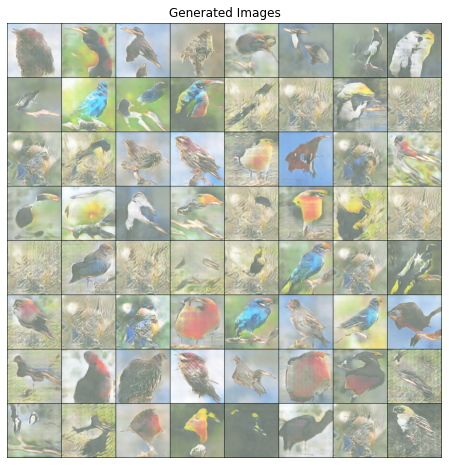

Epoch (54/200) Iteration (31271) Loss_G: 10.0052 Loss_D: 0.0005 D_real: 0.9999 D_fake: 0.0004
Epoch (55/200) Iteration (31861) Loss_G: 9.8150 Loss_D: 0.0033 D_real: 0.9972 D_fake: 0.0005


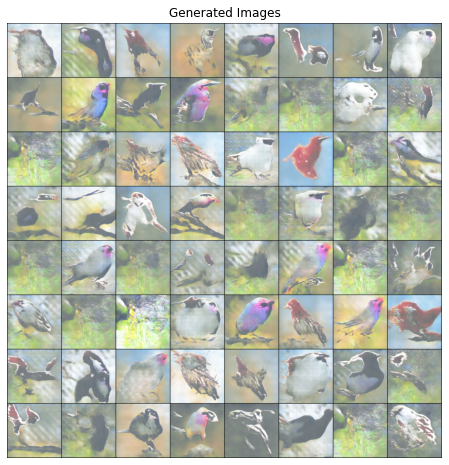

Epoch (56/200) Iteration (32451) Loss_G: 6.4454 Loss_D: 0.0569 D_real: 0.9999 D_fake: 0.0526
Epoch (57/200) Iteration (33041) Loss_G: 9.4134 Loss_D: 0.2362 D_real: 0.9994 D_fake: 0.1553


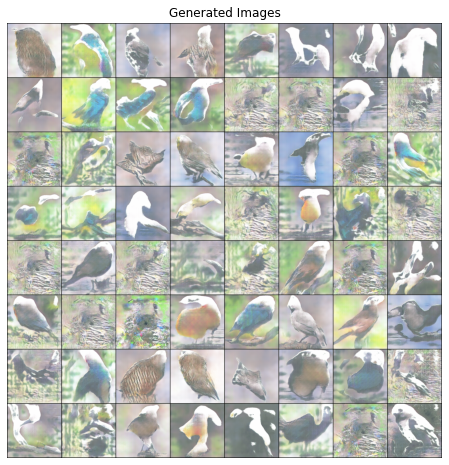

Epoch (58/200) Iteration (33631) Loss_G: 6.6600 Loss_D: 0.0159 D_real: 0.9976 D_fake: 0.0127
Epoch (59/200) Iteration (34221) Loss_G: 6.9828 Loss_D: 0.0153 D_real: 0.9995 D_fake: 0.0144


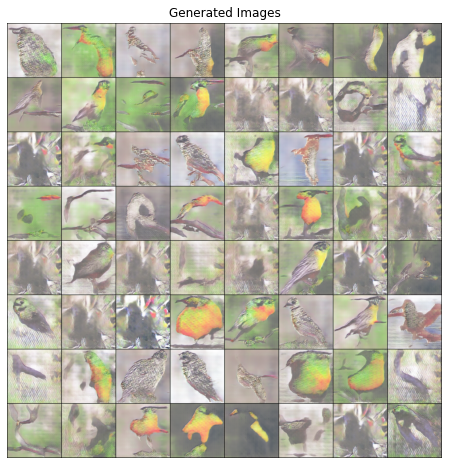

Epoch (60/200) Iteration (34811) Loss_G: 8.5561 Loss_D: 0.0053 D_real: 0.9999 D_fake: 0.0051
Epoch (61/200) Iteration (35401) Loss_G: 14.2383 Loss_D: 0.0432 D_real: 0.9679 D_fake: 0.0000


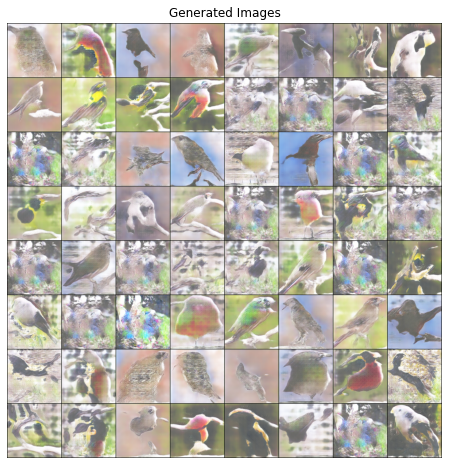

Epoch (62/200) Iteration (35991) Loss_G: 4.6327 Loss_D: 0.0716 D_real: 0.9588 D_fake: 0.0189
Epoch (63/200) Iteration (36581) Loss_G: 7.9022 Loss_D: 0.0043 D_real: 1.0000 D_fake: 0.0042


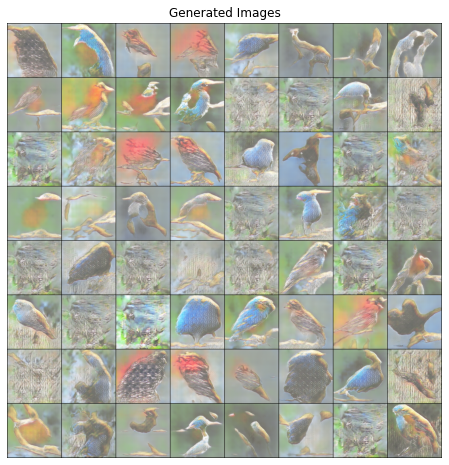

Epoch (64/200) Iteration (37171) Loss_G: 7.1781 Loss_D: 0.1959 D_real: 0.8812 D_fake: 0.0068
Epoch (65/200) Iteration (37761) Loss_G: 5.2486 Loss_D: 0.0294 D_real: 0.9992 D_fake: 0.0272


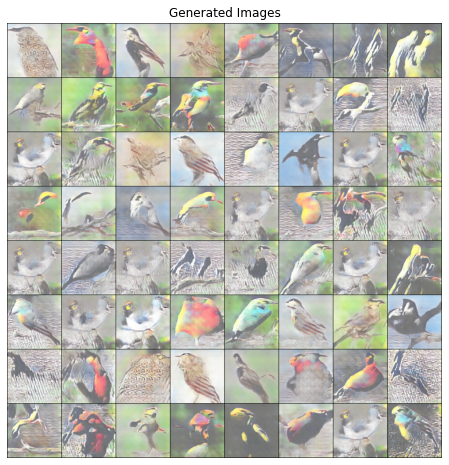

Epoch (66/200) Iteration (38351) Loss_G: 7.2604 Loss_D: 0.0028 D_real: 0.9994 D_fake: 0.0022
Epoch (67/200) Iteration (38941) Loss_G: 7.5290 Loss_D: 0.0219 D_real: 0.9987 D_fake: 0.0164


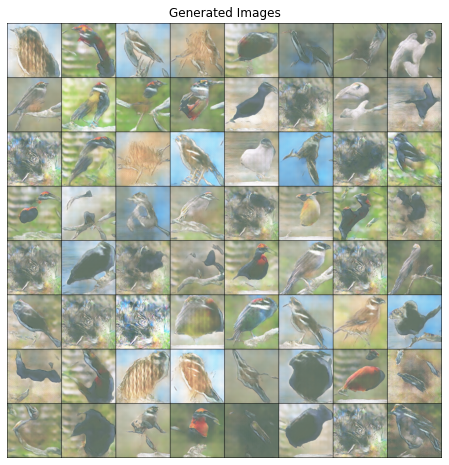

Epoch (68/200) Iteration (39531) Loss_G: 7.1727 Loss_D: 0.0208 D_real: 0.9834 D_fake: 0.0024
Epoch (69/200) Iteration (40121) Loss_G: 13.5198 Loss_D: 0.5232 D_real: 0.9570 D_fake: 0.2682


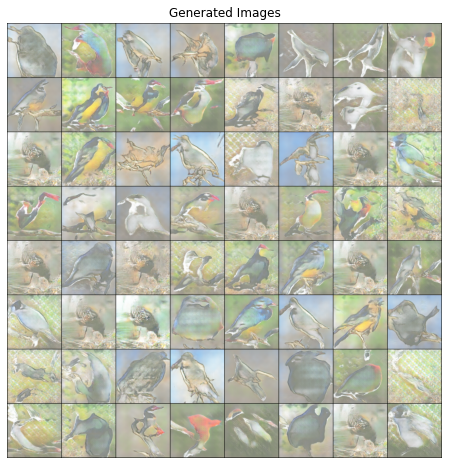

Epoch (70/200) Iteration (40711) Loss_G: 22.1027 Loss_D: 0.8974 D_real: 1.0000 D_fake: 0.4738
Epoch (71/200) Iteration (41301) Loss_G: 6.3470 Loss_D: 0.0117 D_real: 0.9998 D_fake: 0.0111


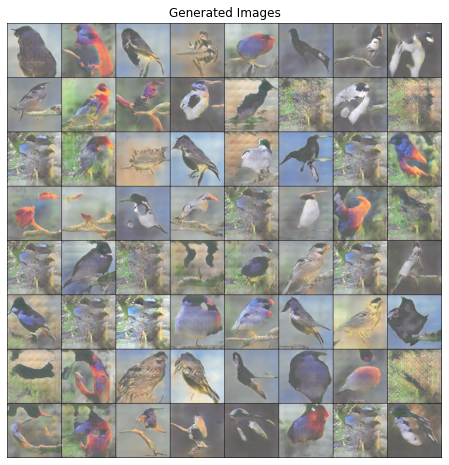

Epoch (72/200) Iteration (41891) Loss_G: 9.4485 Loss_D: 0.1864 D_real: 1.0000 D_fake: 0.1447
Epoch (73/200) Iteration (42481) Loss_G: 21.3261 Loss_D: 1.4767 D_real: 1.0000 D_fake: 0.5883


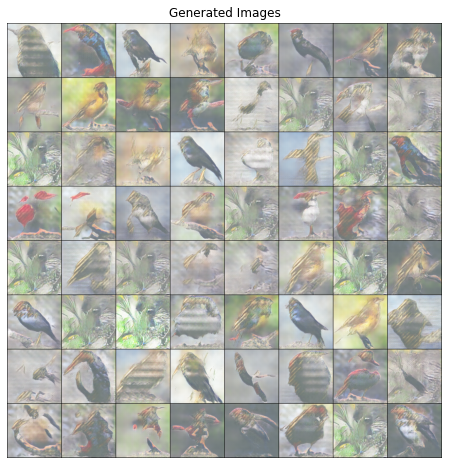

Epoch (74/200) Iteration (43071) Loss_G: 37.3359 Loss_D: 1.9666 D_real: 1.0000 D_fake: 0.7754
Epoch (75/200) Iteration (43661) Loss_G: 26.5428 Loss_D: 2.2375 D_real: 1.0000 D_fake: 0.6747


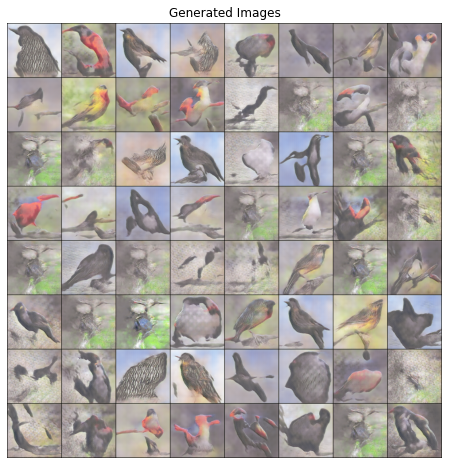

Epoch (76/200) Iteration (44251) Loss_G: 8.7483 Loss_D: 0.0524 D_real: 0.9973 D_fake: 0.0388
Epoch (77/200) Iteration (44841) Loss_G: 8.2607 Loss_D: 0.0416 D_real: 1.0000 D_fake: 0.0377


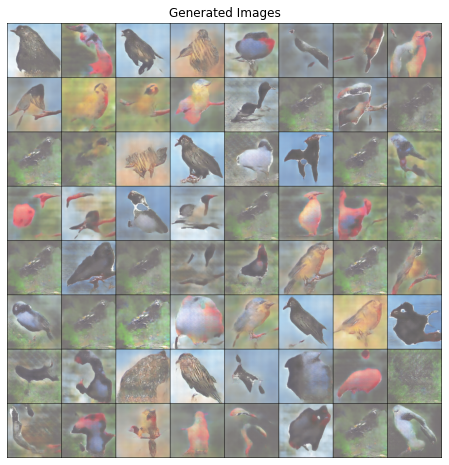

Epoch (78/200) Iteration (45431) Loss_G: 10.3956 Loss_D: 0.1612 D_real: 0.9999 D_fake: 0.1190
Epoch (79/200) Iteration (46021) Loss_G: 6.3623 Loss_D: 0.0427 D_real: 0.9983 D_fake: 0.0386


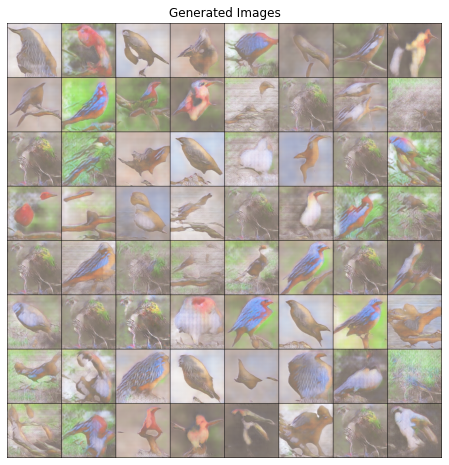

Epoch (80/200) Iteration (46611) Loss_G: 6.7726 Loss_D: 0.0229 D_real: 0.9996 D_fake: 0.0215
Epoch (81/200) Iteration (47201) Loss_G: 6.7025 Loss_D: 0.0360 D_real: 0.9998 D_fake: 0.0303


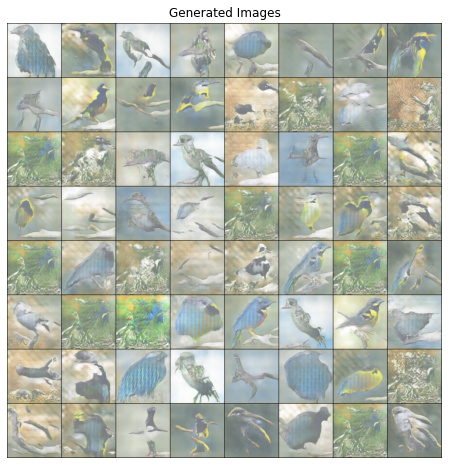

Epoch (82/200) Iteration (47791) Loss_G: 6.1026 Loss_D: 0.0389 D_real: 0.9971 D_fake: 0.0341
Epoch (83/200) Iteration (48381) Loss_G: 6.3889 Loss_D: 0.0150 D_real: 0.9999 D_fake: 0.0141


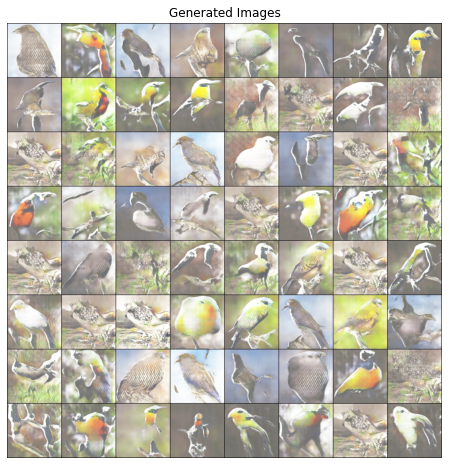

Epoch (84/200) Iteration (48971) Loss_G: 5.0105 Loss_D: 0.0607 D_real: 1.0000 D_fake: 0.0523
Epoch (85/200) Iteration (49561) Loss_G: 12.9662 Loss_D: 0.0576 D_real: 0.9974 D_fake: 0.0486


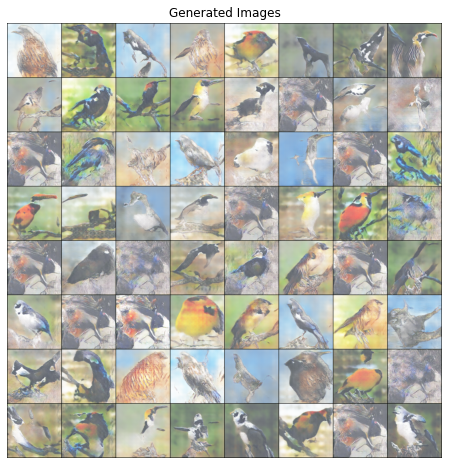

Epoch (86/200) Iteration (50151) Loss_G: 7.3400 Loss_D: 0.0266 D_real: 0.9991 D_fake: 0.0243
Epoch (87/200) Iteration (50741) Loss_G: 16.3258 Loss_D: 0.3738 D_real: 0.9924 D_fake: 0.2390


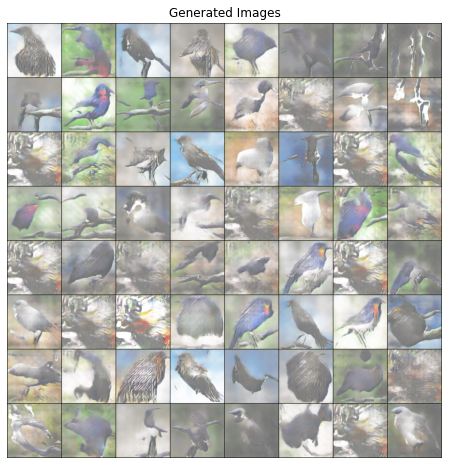

Epoch (88/200) Iteration (51331) Loss_G: 17.2587 Loss_D: 0.8464 D_real: 0.9999 D_fake: 0.4030
Epoch (89/200) Iteration (51921) Loss_G: 4.5581 Loss_D: 3.7935 D_real: 0.1207 D_fake: 0.0000


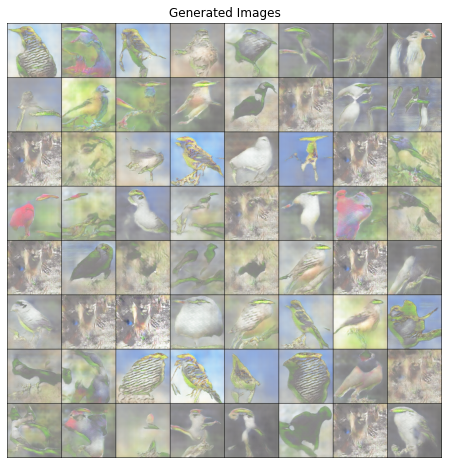

Epoch (90/200) Iteration (52511) Loss_G: 6.2658 Loss_D: 0.0433 D_real: 0.9963 D_fake: 0.0352
Epoch (91/200) Iteration (53101) Loss_G: 14.1631 Loss_D: 0.3626 D_real: 0.8015 D_fake: 0.0000


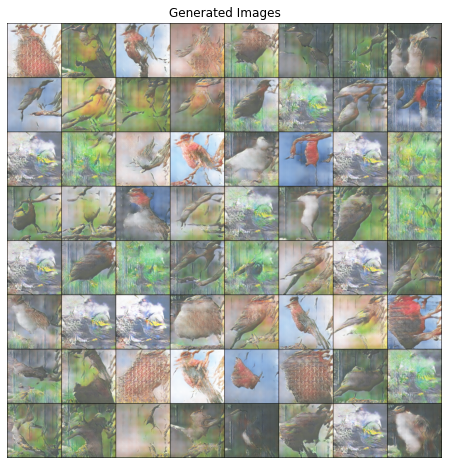

Epoch (92/200) Iteration (53691) Loss_G: 8.8189 Loss_D: 0.0014 D_real: 0.9995 D_fake: 0.0009
Epoch (93/200) Iteration (54281) Loss_G: 49.7301 Loss_D: 0.0000 D_real: 1.0000 D_fake: 0.0000


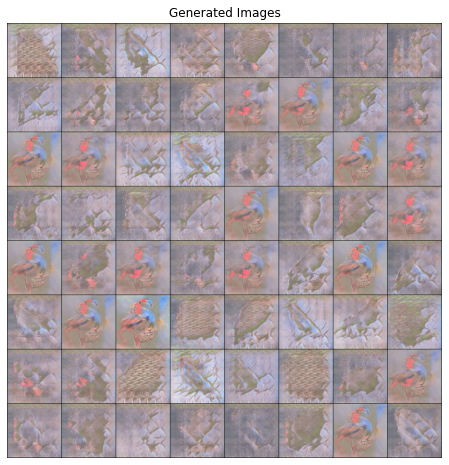

Epoch (94/200) Iteration (54871) Loss_G: 50.1393 Loss_D: 0.0000 D_real: 1.0000 D_fake: 0.0000


KeyboardInterrupt: 

In [7]:
NUM_EPOCHS = 200
LR = 0.001

criterion = nn.BCELoss()
optimizerG = optim.Adam(generator.parameters(), lr=LR, betas=(0.5, 0.999))
optimizerD = optim.Adam(discriminator.parameters(), lr=LR, betas=(0.5, 0.999))

# Fixed noise vector we'll use to track image generation evolution
fixed_noise = torch.randn(BATCH_SIZE, LATENT_SIZE, 1, 1, device=device)

img_list = []
gen_losses = []
dis_losses = []
ITERS = 0

print("Begin training...")

for epoch in range(NUM_EPOCHS):
    for real_batch, _ in data_loader:
        
        optimizerD.zero_grad()

        # Train with real data
        real_batch = real_batch.to(device)
        real_labels = torch.ones((real_batch.shape[0],), dtype=torch.float, device=device)
        output = discriminator(real_batch).view(-1)
        loss_real = criterion(output, real_labels)
        loss_real.backward()
        D_real = output.mean().item()
        
        # Train with fake data
        noise = torch.randn(real_batch.shape[0], LATENT_SIZE, 1, 1, device=device)
        fake_batch = generator(noise)
        fake_labels = torch.zeros_like(real_labels)           
        output = discriminator(fake_batch.detach()).view(-1)  
        loss_fake = criterion(output, fake_labels)
        loss_fake.backward()                      
        D_fake = output.mean().item()
        
        # Update discriminator weights and store loss
        optimizerD.step()
        loss_dis = loss_real + loss_fake
        
        ### STEP 2: train generator
        optimizerG.zero_grad()
        output = discriminator(fake_batch).view(-1)
        loss_gen = criterion(output, real_labels)
        loss_gen.backward()
        
        # Update generator weights and store loss
        optimizerG.step()
        
        # Track losses for later use
        gen_losses.append(loss_gen.item())
        dis_losses.append(loss_dis.item())
        
        if (epoch == 0 and ITERS % 50 == 0) or (epoch != last_reported):    # Reduce verbosity to once every epoch after first epoch
            if epoch == 1:
                print("\nPrinting every epoch to reduce verbosity\n")
            print(f"Epoch ({epoch + 1}/{NUM_EPOCHS})",
                  f"Iteration ({ITERS + 1})",
                  f"Loss_G: {loss_gen.item():.4f}",
                  f"Loss_D: {loss_dis.item():.4f}",
                  f"D_real: {D_real:.4f}",  
                  f"D_fake: {D_fake:.4f}")
            last_reported = epoch
        ITERS += 1
    
    ### Store loss and track image evolution (tracking image every 2 epochs to reduce memory usage)
    if epoch % 2 == 0:
        with torch.no_grad():
            fake_images = generator(fixed_noise).detach().cpu()
        img_list.append(utils.make_grid(fake_images, nrow=8, normalize=True))
        
        # Display generated images during training
        plt.figure(figsize=(8, 8)); plt.axis("off"); plt.title("Generated Images")
        plt.imshow(np.transpose(img_list[-1], (1,2,0)));
        plt.show()
        
print("Finished training!")

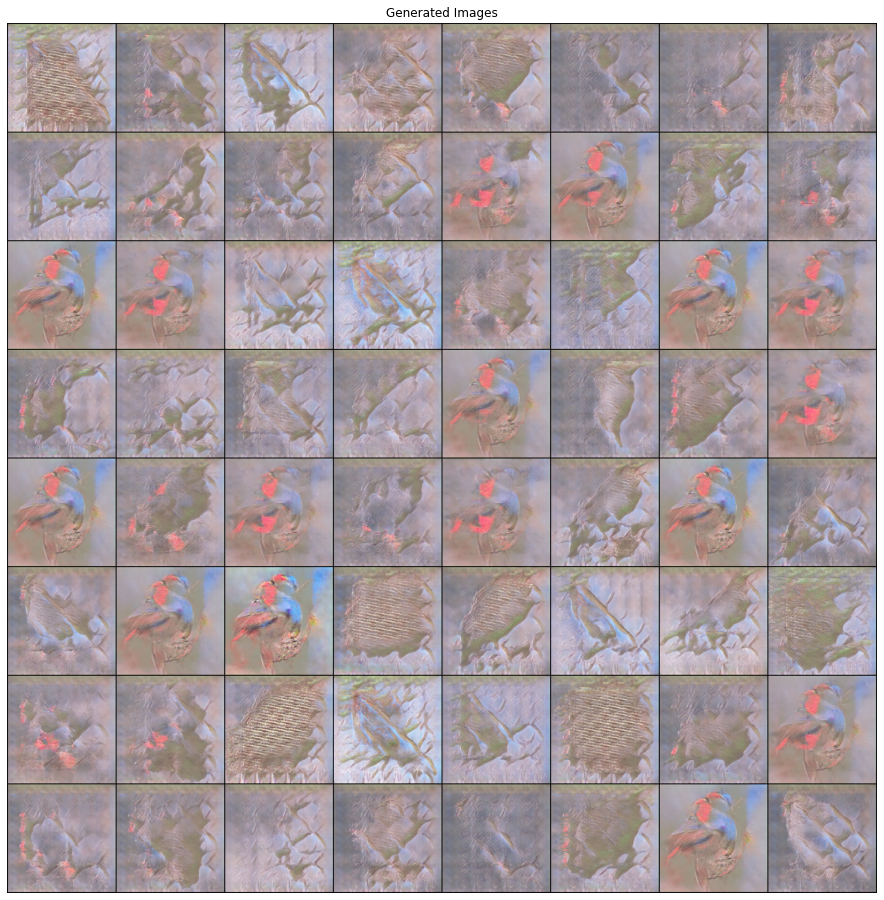

In [19]:
# Last generated image. In the end, discriminator overpowered generator
plt.figure(figsize=(16, 16)); plt.axis("off"); plt.title("Generated Images")
fake_sample = img_list[-1]
plt.imshow(np.transpose(fake_sample,(1,2,0)));

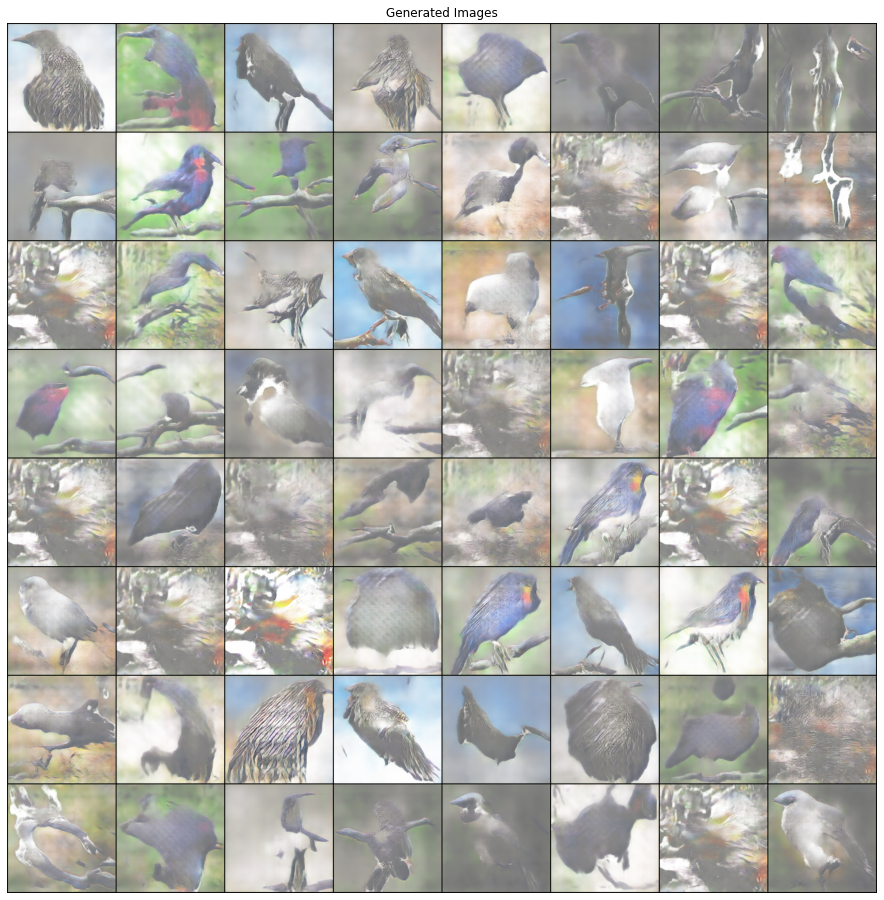

In [20]:
# In contrast, images generated in epoch 87 look more realistic
plt.figure(figsize=(16, 16)); plt.axis("off"); plt.title("Generated Images")
fake_sample = img_list[-4]
plt.imshow(np.transpose(fake_sample,(1,2,0)));

In [11]:
GEN_PATH = "models/GAN_generator.pt"
torch.save(generator.state_dict(), GEN_PATH)
DIS_PATH = "models/GAN_discriminator.pt"
torch.save(discriminator.state_dict(), DIS_PATH)  

In [12]:
with open('models/GAN_img_list.pickle', 'wb') as f:
    pickle.dump(img_list, f, pickle.HIGHEST_PROTOCOL)

In [18]:
%%capture
fig = plt.figure(figsize=(16, 16)); plt.axis("off"); plt.title("Generated Images")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)
ani.save('models/GAN.gif', writer='imagemagick', fps=2)
HTML(ani.to_jshtml())